## FINM 33150 Final Project Draft (html version is included as well)



### Temporary Title: 

$$ Pair \ Trading \ Using \ Distance \ Method \ in \ Crypto \ Market $$

###  Group Members:  
$$ Xuyang \ (Dennis) \ Hua -- ID: 12375236 \\ $$
$$ Sihui \ (Livia) \ Li -- ID: 12167227 \\ $$
$$ Yichen \ (Allen) \ Lyu -- ID: 12370471\\ $$
$$ Xiaoyi \ (Yuna) \ Ge -- ID: 12370334 \\ $$

<br>

### 1. Introduction 

### Asset Class Choosing: Why Crypto? - Cryptocurrency Market Overview

- Cryptocurrency is known as a digital currency that operates using a decentralized system, meaning that it is free of limitations neither central issuing nor authority regulations. Relying on blockchain and other cryptographic technologies to authenticate transactions, it ensures buyers and sellers with adequate security, transparency, and  immutability of transactions.


- Aside from the extent of financial freedom and privacy that it provides people with, it is also an attractive investment for investors because of the high returns due to its volatility. This could come from various factors including the market demand and rationality, government regulatory policies, or potential security concerns. 


- In reality,  the cryptocurrency market has exhibited significant growth and volatility since its inception, with a current market capitalization of over 2 trillion. Currently, Bitcoin is the largest cryptocurrency by market capitalization, which has surpassed the 50,000 mark for the first time in several months but also experienced several significant dips in its value. Other major cryptocurrencies including Ethereum, Binance Coin, and Cardano also had significant gains in value. Simultaneously, there were also concerns about the sustainability of the market's growth.


- While high volatility could indicate severe risks for investors, with proper analysis of the underlying technical patterns of particular cryptocurrencies and strategic intra-day trading, we might be able to generate returns from these volatile movements. In this project, we will not discuss in detail the commonly known properties of cryptocurrencies and the mechanics behind them, but will instead focus on analyzing the crypto-market performance and the profitability of quantitative trading strategies associated with cryptocurrencies, namely, pair trading using the Distance Method.

### Literature Review

- We investigated the statistical arbitrage methods commonly used in the cryptocurrency market to establish a quantitative trading strategy. These include mean reversion, pairs trading, and momentum strategies.


- In mean reversion strategies, traders assume that the price of an asset will eventually return to its expected value and try to identify occurrences where the price of a particular cryptocurrency deviates from its historical average. On the other hand, pairs trading involves buying one cryptocurrency and simultaneously selling another similar one,  with the anticipation that the relative differences of prices of the two assets will converge eventually.  In momentum strategies for cryptocurrency trading, traders look for strong price movement patterns in a singular direction and trades on its continuing growth.


- Pair trading presents as a simple but profitable strategy throughout a long time in different studies and empirical tests. Following Kolmogorov and Ramazanov (2019)’s research, we discovered common pair trading strategies including the distance method, cointegration method, and copula method. The “Distance Method” stands out as a very flexible option for trading cryptocurrencies. 


- Gatev et al. (2006)  invented this simple pair trading strategy called the Distance Method. He discovered its remarkable profits over an extended period, specifically, throughout 196 years of US stock market data. The Distance Method quantifies the relative “distance” between two cryptocurrencies based on statistical measures, and chooses to buy or hold one of the assets whenever the distance exceeds a predetermined threshold. This brought our attention to this old-fashioned but popular strategy and its historical profitability as examined in previous research.

- On the contrary, according to Do and Faff (2012), the profitability of pairs trading has decreased due to fewer arbitrage opportunities in the market, evidenced by the rise in the number of the cryptocurrencies pairs that never converge as anticipated. They studied pairs trading profitability across a range of US equity sectors, but found out that the profitability for pairs trading decreased as trading costs were incorporated. The study discovered that one could attain potentially higher profits in less liquid and less efficient markets, which somewhat aligns with the Efficient Market Hypothesis. 


### Motivation on Our Strategy

- While some disputes centering around the robustness of different pair trading strategies exist, in the paper “Pairs Trading in Cryptocurrency Markets” by Jacobs and Weber (2015),  the authors investigated the application of pairs trading strategy in cryptocurrency markets and analyzed its profitability using a sample of 10 major cryptocurrencies. They found out that pairs trading strategies in fact could be profitable and were robust to transaction costs. Although the results varied for different cryptocurrencies and strategies, the highest returns were observed for pairs involving Bitcoin. 


- The truth of profitability cannot be generalized for the cryptocurrency market, which is why we will experiment with the traditional “Distance Method”, following the customized procedures. We will build up the strategy starting with 10 pairs of cryptocurrencies and make selections based on some established criterion. 


- Therefore, we will reference previous research papers on pair trading strategies including “Pairs Trading in Cryptocurrency Markets” by Miroslav Fil and Ladislav Kristoufek (2018). We replicate their methodologies or decision making to a certain extent. Replications and discretionary changes will either be documented or justified.


### 2. Strategy Introduction

### Pair Trading Strategy using Distance Method

- Begin with the original dataset. First, we gathered data from 11 cryptocurrencies including Bitcoin that have been actively traded since 2019 with a 1-hour frequency from Binance to form 10 pairs with Bitcoin.​


- We calculate and rank pair wise SSD (sum of squared deviations). Here, we will use the cryptocurrencies' closing price and more importantly, the SSD is between the normalized logarithmic price series of the paired assets. 


- The sum of squared deviations between two normalized logarithmic price series of assets i and j, simply labeled as P here: 

$$ SSD_{ij} = \sum_{t} (P_{it} - P_{jt})^{2} $$

- Then, select top 5 pairs with smallest SSD. Start trading: creating spread, calculating the difference between normalized price in the spread:

$$ spread_{ijt} = P_{it} - P_{jt} $$

- From the spread, the trading signals are as following: 

$$ \ sd \leq -2 \ : \ Long \ the \ Spread \\ -2 < \ sd \ < 2 \ : \ Close \ the\ Position \\ sd \geq 2 \ : \ Short \ the\ Spread \\ $$

- At the same time, if stop loss is triggered, we will close the position.

### 3. Get Cryptodata From Binance

### Notice: Some of the code in section 3 and section 4 will be wrapped into functions in the final version. Most of the functions will be included in another util file in the final version as well.

In [4]:
import ccxt
import pandas as pd
import numpy as np
import urllib
import json
from typing import List
import datetime as dt
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

from functools import reduce

#### Notice: Since Binance has location restriction, the United States users do not have accessibility of the data directly. We obtain the data using the following function in a different IP location and stored selected cryptocurrencies in csv files with frequency hourly.  Functions are displayed since we have used it. 

In [2]:
def get_all_symbols() -> List:
    response = urllib.request.urlopen(
        "https://api.binance.us/api/v3/exchangeInfo").read() 
    return list(
        map(lambda symbol: symbol['symbol'], json.loads(response)['symbols']))

In [3]:
def fetch_data_binance(coin: str, timeframe: str, start: str, stop: str) -> None:
    print(f'fetching {coin} ...')
    exchange = ccxt.binance()
    start = exchange.parse8601(start + '00:00:00')
    stop = exchange.parse8601(stop + '00:00:00')
    
    segments = []
    while start < stop:
        data = exchange.fetch_ohlcv(coin, timeframe, start, 1000)
        segments.append(pd.DataFrame(data))
        start+=60000000
    
    total = pd.concat(segments)
    total.drop_duplicates(inplace=True)
    total.columns = list('tohlcv')
    
    return total

#### Load CSV files

In [2]:
def load_and_clean_data(csv_file: str):
    df = pd.read_csv(csv_file)
    df['Log_close'] = np.log(df['c'])
    df['time'] = df['t'].apply(lambda x: dt.datetime.utcfromtimestamp(x/1e3))
    df.set_index('time', inplace = True)
    df.rename(columns={"o": "Open", "h": "High", "l": "Low", "c":"Close", "v" : "Volume"}, inplace = True)
    df.drop(columns=['Unnamed: 0', 't'], inplace = True)
    df.index.name = 'Time'
    df['Hourly Return'] = df['Close'].pct_change()
    
    return df

#### Here, we displayed BTC as an example

In [6]:
BTC_Data = load_and_clean_data('C:\\Users\\Owner\\PycharmProjects\\crypto_data\\BTCUSDT_1h_20190101_20191231.csv')

In [7]:
BTC_Data

,Open,High,Low,Close,Volume,Log_close,Hourly Return
Time,,,,,,,
2019-01-01 00:00:00,3701.23,3713.00,3689.88,3700.31,686.367420,8.216172,NaN
2019-01-01 01:00:00,3700.20,3702.73,3684.22,3689.69,613.539115,8.213298,-0.002870
2019-01-01 02:00:00,3689.67,3695.95,3675.04,3690.00,895.302181,8.213382,0.000084
2019-01-01 03:00:00,3690.00,3699.77,3685.78,3693.13,796.714818,8.214230,0.000848
2019-01-01 04:00:00,3692.32,3720.00,3685.94,3692.71,1317.452909,8.214116,-0.000114
...,...,...,...,...,...,...,...
2020-02-10 10:00:00,9835.21,9872.00,9820.79,9847.78,3918.833069,9.195001,0.001279
2020-02-10 11:00:00,9848.63,9848.98,9765.00,9821.43,3542.078136,9.192322,-0.002676
2020-02-10 12:00:00,9821.41,9848.63,9777.60,9845.86,2649.527579,9.194806,0.002487


#### Then, we collected the hourly return from the 10 different cryptocurrencies and put them in one dataframe

In [10]:
label_list = ['BTC','ADA', 'BNB', 'DOGE', 'DOT', 'ETH', 'LINK', 'LTC', 'MATIC', 'SOL']
mlist = []

for coin in label_list:
    filepath = f'C:\\Users\\Owner\\PycharmProjects\\crypto_data\\{coin}USDT_1h_20190101_20191231.csv'
    df = load_and_clean_data(filepath)
    df.rename(columns = {'Hourly Return' : f'{coin} Hourly Return'}, inplace = True)
    mlist.append(df[f'{coin} Hourly Return'])


In [11]:
Crypto_Returns = pd.merge(mlist[0], mlist[1], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[2], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[3], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[4], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[5], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[6], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[7], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[8], left_index = True, right_index = True, how = 'left')
Crypto_Returns = pd.merge(Crypto_Returns, mlist[9], left_index = True, right_index = True, how = 'left')

Crypto_Returns

,BTC Hourly Return,ADA Hourly Return,BNB Hourly Return,DOGE Hourly Return,DOT Hourly Return,ETH Hourly Return,LINK Hourly Return,LTC Hourly Return,MATIC Hourly Return,SOL Hourly Return
Time,,,,,,,,,,
2019-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-01 01:00:00,-0.002870,-0.008674,-0.009996,NaN,NaN,-0.005159,NaN,-0.007343,NaN,NaN
2019-01-01 02:00:00,0.000084,-0.002250,-0.007857,NaN,NaN,-0.003203,NaN,-0.000672,NaN,NaN
2019-01-01 03:00:00,0.000848,0.007266,-0.011845,NaN,NaN,0.004590,NaN,0.002019,NaN,NaN
2019-01-01 04:00:00,-0.000114,0.005721,0.008986,NaN,NaN,0.007843,NaN,0.004701,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,0.001279,0.004735,0.008626,0.008381,NaN,0.004700,-0.000630,0.000273,-0.004733,NaN
2020-02-10 11:00:00,-0.002676,-0.007742,-0.007188,-0.010615,NaN,-0.006859,-0.004324,-0.000273,-0.009986,NaN
2020-02-10 12:00:00,0.002487,0.002205,0.012150,-0.005601,NaN,0.005946,0.013088,0.009285,0.004803,NaN


#### Correlation Analysis and Graphs

In [12]:
Correlation_Matrix = Crypto_Returns.corr()
Correlation_Matrix

,BTC Hourly Return,ADA Hourly Return,BNB Hourly Return,DOGE Hourly Return,DOT Hourly Return,ETH Hourly Return,LINK Hourly Return,LTC Hourly Return,MATIC Hourly Return,SOL Hourly Return
BTC Hourly Return,1.000000,0.634921,0.526541,0.621434,NaN,0.776055,0.322950,0.694429,0.203588,NaN
ADA Hourly Return,0.634921,1.000000,0.506762,0.494676,NaN,0.732979,0.340836,0.696690,0.241986,NaN
BNB Hourly Return,0.526541,0.506762,1.000000,0.496970,NaN,0.548791,0.290338,0.519026,0.253723,NaN
DOGE Hourly Return,0.621434,0.494676,0.496970,1.000000,NaN,0.558837,0.360319,0.506050,0.213781,NaN
DOT Hourly Return,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ETH Hourly Return,0.776055,0.732979,0.548791,0.558837,NaN,1.000000,0.345655,0.785683,0.236645,NaN
LINK Hourly Return,0.322950,0.340836,0.290338,0.360319,NaN,0.345655,1.000000,0.318755,0.129949,NaN
LTC Hourly Return,0.694429,0.696690,0.519026,0.506050,NaN,0.785683,0.318755,1.000000,0.227471,NaN
MATIC Hourly Return,0.203588,0.241986,0.253723,0.213781,NaN,0.236645,0.129949,0.227471,1.000000,NaN
SOL Hourly Return,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Text(0.5, 1.0, 'Correlation Heatmap on Cryptocurrencies Hourly Return')

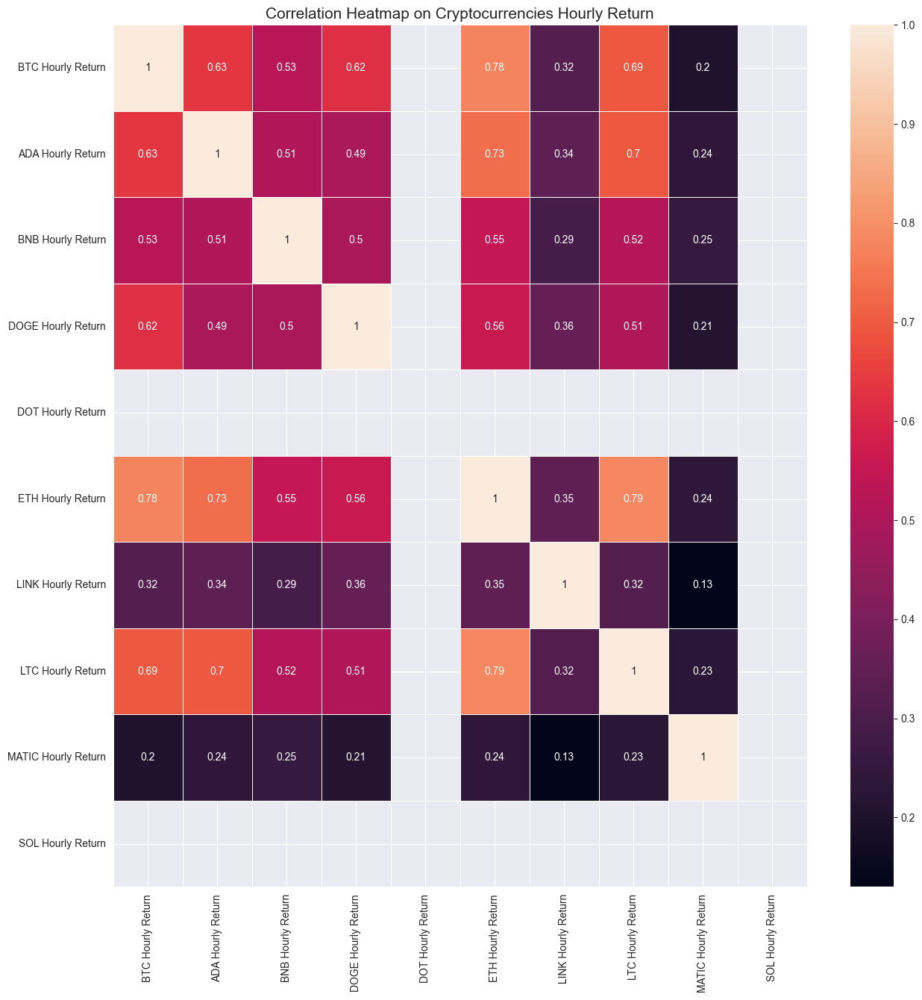

In [13]:
plt.figure(figsize = (15,15))
corr_heatmap = sns.heatmap(Correlation_Matrix, annot=True, linewidths=.5)
corr_heatmap.set_title('Correlation Heatmap on Cryptocurrencies Hourly Return', fontsize =15)

#### Discussion: 

- From the heatmap, we visualize that the hourly return of BTC in percentage has a fairly high correlation with mostly all of the other cryptocurrencies. This is not quite surprising since BTC is a relative stable and mature cryptocurrency. As we have discussed in the introduction section, one could use the trend of BTC as the overall trend in the cryptocurrency market since the market does not truely depends on other macro factors.

#### General graphs and analysis

In [14]:
label_list = ['BTC','ADA', 'BNB', 'DOGE', 'DOT', 'ETH', 'LINK', 'LTC', 'MATIC', 'SOL']
plist = []

for coin in label_list:
    filepath = f'C:\\Users\\Owner\\PycharmProjects\\crypto_data\\{coin}USDT_1h_20190101_20191231.csv'
    df = load_and_clean_data(filepath)
    df.rename(columns = {'Close' : f'{coin} Close Price'}, inplace = True)
    plist.append(df[f'{coin} Close Price'])


In [15]:
Crypto_Price = pd.merge(plist[0], plist[1], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[2], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[3], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[4], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[5], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[6], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[7], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[8], left_index = True, right_index = True, how = 'left')
Crypto_Price = pd.merge(Crypto_Price, plist[9], left_index = True, right_index = True, how = 'left')

Crypto_Price

,BTC Close Price,ADA Close Price,BNB Close Price,DOGE Close Price,DOT Close Price,ETH Close Price,LINK Close Price,LTC Close Price,MATIC Close Price,SOL Close Price
Time,,,,,,,,,,
2019-01-01 00:00:00,3700.31,0.04035,6.0425,NaN,NaN,131.82,NaN,29.96,NaN,NaN
2019-01-01 01:00:00,3689.69,0.04000,5.9821,NaN,NaN,131.14,NaN,29.74,NaN,NaN
2019-01-01 02:00:00,3690.00,0.03991,5.9351,NaN,NaN,130.72,NaN,29.72,NaN,NaN
2019-01-01 03:00:00,3693.13,0.04020,5.8648,NaN,NaN,131.32,NaN,29.78,NaN,NaN
2019-01-01 04:00:00,3692.71,0.04043,5.9175,NaN,NaN,132.35,NaN,29.92,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,9847.78,0.05942,24.6373,0.002996,NaN,220.16,3.3304,73.26,0.02103,NaN
2020-02-10 11:00:00,9821.43,0.05896,24.4602,0.002964,NaN,218.65,3.3160,73.24,0.02082,NaN
2020-02-10 12:00:00,9845.86,0.05909,24.7574,0.002947,NaN,219.95,3.3594,73.92,0.02092,NaN


In [16]:
fig = px.line(Crypto_Price, x=Crypto_Price.index, y=Crypto_Price.columns[0:10], labels={
                     "value": "Price in USD",
                     "Time": "Date"
                 },title='Selected Cryptocurrencies Close Price')

fig.show()

In [14]:
fig = px.line(Crypto_Price, x=Crypto_Price.index, y=Crypto_Price.columns[1:10], labels={
                     "value": "Price in USD",
                     "Time": "Date"}, 
             title = 'Selected Crypocurrencies Close Price (BTC excluded)')
fig.show()

In [15]:
fig = px.line(Crypto_Returns, x=Crypto_Returns.index, y=Crypto_Returns.columns[0:10], labels={
                     "value": "Hourly Return in Percentage",
                     "Time": "Date"}, 
             title = 'Selected Cryptocurrencies Hourly Return')
fig.show()

#### Discussion: 

- In the cryptocurrencies' close price graphs, we have a slightly zoom-in version of the graph (the second one) since BTC's price is way higher than other cryptocurrencies in terms of USD. Comparing the first graph and the second one, we could say that the other cryptocurrencies kinda following the BTC's trend. 

- The hourly return graph won't tell much about the relationships between those currencies. However, we could spot some outliners easily from the hourly return graph, such as MATIC and LINK.

### 4. Pre-step Before Simulation

#### Right now, We collected ten cryptocurrencies data unitl Feb. 2020. However, the closed price for DOT and SOL won't be available until the beginning of 2021. Therefore, we didn't put these two currencies under consideration for now. We pick the dataframe since Aug 2019 to compute the other 7 pairs of cryptos' ssd and compare their sum of Squared Deviations to selected 5 pairs which minimize the sum of Squared Deviations.

- The rationale behind this is that pairs with smaller SSD are likely to have a more stable and predictable relationship, which can provide a better foundation for executing a profitable trading strategy.


- When two assets have a stable and predictable relationship, it becomes easier to identify when the relationship deviates from the norm, and when it is likely to return to its usual pattern. This allows pair traders to take advantage of the expected mean reversion by buying the underperforming asset and selling the overperforming asset.


- Furthermore, pairs with smaller SSD may also have lower risk and higher liquidity, as they are less likely to experience sudden and large price movements that can lead to losses. This can make it easier to manage risk and execute trades with a higher degree of confidence.

- Recall the SSD formula: 

$$ SSD_{ij} = \sum_{t} (P_{it} - P_{jt})^{2} $$


In [19]:
Crypto_Price_since_2019_8 = Crypto_Price.loc['2019-08-01':].dropna(axis=1)
Crypto_Price_since_2019_8 

,BTC Close Price,ADA Close Price,BNB Close Price,DOGE Close Price,ETH Close Price,LINK Close Price,LTC Close Price,MATIC Close Price
Time,,,,,,,,
2019-08-01 00:00:00,10043.02,0.05959,27.6226,0.002853,216.15,2.2037,97.63,0.01136
2019-08-01 01:00:00,10020.29,0.05940,27.5991,0.002834,213.47,2.2086,97.23,0.01127
2019-08-01 02:00:00,10029.27,0.05943,27.6257,0.002865,214.38,2.2200,97.13,0.01151
2019-08-01 03:00:00,9988.02,0.05926,27.6750,0.002850,213.78,2.2072,96.71,0.01137
2019-08-01 04:00:00,9977.28,0.05927,27.6628,0.002835,213.40,2.1851,96.67,0.01129
...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,9847.78,0.05942,24.6373,0.002996,220.16,3.3304,73.26,0.02103
2020-02-10 11:00:00,9821.43,0.05896,24.4602,0.002964,218.65,3.3160,73.24,0.02082
2020-02-10 12:00:00,9845.86,0.05909,24.7574,0.002947,219.95,3.3594,73.92,0.02092


In [17]:
def computessd(Crypto_Price: pd.DataFrame, crypto: str, use_log: bool = False) -> float:
    btc_p = Crypto_Price['BTC Close Price']
    crypto_p = Crypto_Price[crypto.upper() + ' Close Price']

    if use_log:
        btc_p = np.log(btc_p)
        crypto_p = np.log(crypto_p)

    btc_p = (btc_p - np.mean(btc_p)) / np.std(btc_p)
    crypto_p = (crypto_p - np.mean(crypto_p)) / np.std(crypto_p)
    
    ssd = np.sum((btc_p - crypto_p) ** 2)
    return ssd

In [20]:
eth_ssd = computessd(Crypto_Price_since_2019_8,'eth')
ada_ssd = computessd(Crypto_Price_since_2019_8,'ada')
bnb_ssd = computessd(Crypto_Price_since_2019_8,'bnb')
matic_ssd = computessd(Crypto_Price_since_2019_8,'matic')
doge_ssd = computessd(Crypto_Price_since_2019_8,'doge')
#sol_ssd = computessd(Crypto_Price_since_2019_8,'sol')
#dot_ssd = computessd(Crypto_Price_since_2019_8,'dot')
ltc_ssd = computessd(Crypto_Price_since_2019_8,'ltc')
link_ssd = computessd(Crypto_Price_since_2019_8,'link')

,SSD
Pair,
LTC/BTC,509.644215
BNB/BTC,802.749782
ETH/BTC,1398.641616
ADA/BTC,1613.831594
DOGE/BTC,2079.543083
LINK/BTC,8087.356959
MATIC/BTC,11566.582591


In [ ]:
ssds = {
    'ETH/BTC':eth_ssd,
    'ADA/BTC':ada_ssd,
    'BNB/BTC':bnb_ssd,
    'MATIC/BTC':matic_ssd,
    'DOGE/BTC':doge_ssd,
    #'SOL/BTC':sol_ssd,
    #'DOT/BTC':dot_ssd,
    'LTC/BTC':ltc_ssd,
    'LINK/BTC':link_ssd,
}
ssd_pd = pd.DataFrame(ssds.items(), columns=['Pair', 'SSD'])
ssd_pd = ssd_pd.set_index('Pair').sort_values(by = 'SSD')
ssd_pd

#### By comparing the SSD we calculated, we can tell during this period, five pairs formed by LTC/BTC, BNB/BTC, ETH/BTC, ADA/BTC and DOGE/BTC have minimized sum of Squared Deviations. At this point, we would like use these five pairs to create the trading portfolio.

<br>

#### Graph of Pair LTC/BTC

In [ ]:
LTC_BTC = Crypto_Returns[['BTC Hourly Return', 'LTC Hourly Return']]
LTC_BTC['BTC CumSum'] = LTC_BTC['BTC Hourly Return'].cumsum()
LTC_BTC['LTC CumSum'] = LTC_BTC['LTC Hourly Return'].cumsum()
LTC_BTC = LTC_BTC.loc['2019-08-01':]
LTC_BTC = LTC_BTC[['BTC CumSum', 'LTC CumSum']]
fig = px.line(LTC_BTC, x=LTC_BTC.index, y=LTC_BTC.columns, labels={"value":"Cumulative Return in Percentage", "Time":"Date"}, title = 'LTC and BTC Cumulative Hourly Return in Percentage')
fig.show()

#### Graph of Pair BNB/BTC

In [ ]:
BNB_BTC = Crypto_Returns[['BTC Hourly Return', 'BNB Hourly Return']]
BNB_BTC['BTC CumSum'] = BNB_BTC['BTC Hourly Return'].cumsum()
BNB_BTC['BNB CumSum'] = BNB_BTC['BNB Hourly Return'].cumsum()
BNB_BTC = BNB_BTC.loc['2019-08-01':]
BNB_BTC = BNB_BTC[['BTC CumSum', 'BNB CumSum']]
fig = px.line(BNB_BTC, x=BNB_BTC.index, y=BNB_BTC.columns, labels={"value":"Cumulative Return in Percentage", "Time":"Date"}, title = 'BNB and BTC Cumulative Hourly Return in Percentage')
fig.show()

#### Graph of Pair ETH/BTC

In [ ]:
ETH_BTC = Crypto_Returns[['BTC Hourly Return', 'ETH Hourly Return']]
ETH_BTC['BTC CumSum'] = ETH_BTC['BTC Hourly Return'].cumsum()
ETH_BTC['ETH CumSum'] = ETH_BTC['ETH Hourly Return'].cumsum()
ETH_BTC = ETH_BTC.loc['2019-08-01':]
ETH_BTC = ETH_BTC[['BTC CumSum', 'ETH CumSum']]
fig = px.line(ETH_BTC, x=ETH_BTC.index, y=ETH_BTC.columns, labels={"value":"Cumulative Return in Percentage", "Time":"Date"}, title = 'ETH and BTC Cumulative Hourly Return in Percentage')
fig.show()

#### Graph of Pair ADA/BTC

In [ ]:
ADA_BTC = Crypto_Returns[['BTC Hourly Return', 'ADA Hourly Return']]
ADA_BTC['BTC CumSum'] = ADA_BTC['BTC Hourly Return'].cumsum()
ADA_BTC['ADA CumSum'] = ADA_BTC['ADA Hourly Return'].cumsum()
ADA_BTC = ADA_BTC.loc['2019-08-01':]
ADA_BTC = ADA_BTC[['BTC CumSum', 'ADA CumSum']]
fig = px.line(ADA_BTC, x=ADA_BTC.index, y=ADA_BTC.columns, labels={"value":"Cumulative Return in Percentage", "Time":"Date"}, title = 'ADA and BTC Cumulative Hourly Return in Percentage')
fig.show()

#### Graph of Pair DOGE/BTC

In [ ]:
DOGE_BTC = Crypto_Returns[['BTC Hourly Return', 'DOGE Hourly Return']]
DOGE_BTC['BTC CumSum'] = DOGE_BTC['BTC Hourly Return'].cumsum()
DOGE_BTC['DOGE CumSum'] = DOGE_BTC['DOGE Hourly Return'].cumsum()
DOGE_BTC = DOGE_BTC.loc['2019-08-01':]
DOGE_BTC = DOGE_BTC[['BTC CumSum', 'DOGE CumSum']]
fig = px.line(DOGE_BTC, x=DOGE_BTC.index, y=DOGE_BTC.columns, labels={"value":"Cumulative Return in Percentage", "Time":"Date"}, title = 'DOGE and BTC Cumulative Hourly Return in Percentage')
fig.show()

#### Discussion:

- From the above five graphs, we are able to conclude that the pairs we have selected are closely related in terms of moving trend on cumulative returns. Trading signals will be explored in the next steps and more stats will be displayed later. 

### Next Step

- After we decided the pairs for each trading periods, we will further investigate the correlation between those pairs and optimized their weighted in our portfolio. Then, we will run the each pair with distance method pari trading strategy where long signal will be created when price exceed the 2 standard deviation and short signal will be created  when price is down below -2 standard deviation. The position will be closed while the price is close to the mean of normalized prices.

In [21]:
Crypto_Price

,BTC Close Price,ADA Close Price,BNB Close Price,DOGE Close Price,DOT Close Price,ETH Close Price,LINK Close Price,LTC Close Price,MATIC Close Price,SOL Close Price
Time,,,,,,,,,,
2019-01-01 00:00:00,3700.31,0.04035,6.0425,NaN,NaN,131.82,NaN,29.96,NaN,NaN
2019-01-01 01:00:00,3689.69,0.04000,5.9821,NaN,NaN,131.14,NaN,29.74,NaN,NaN
2019-01-01 02:00:00,3690.00,0.03991,5.9351,NaN,NaN,130.72,NaN,29.72,NaN,NaN
2019-01-01 03:00:00,3693.13,0.04020,5.8648,NaN,NaN,131.32,NaN,29.78,NaN,NaN
2019-01-01 04:00:00,3692.71,0.04043,5.9175,NaN,NaN,132.35,NaN,29.92,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,9847.78,0.05942,24.6373,0.002996,NaN,220.16,3.3304,73.26,0.02103,NaN
2020-02-10 11:00:00,9821.43,0.05896,24.4602,0.002964,NaN,218.65,3.3160,73.24,0.02082,NaN
2020-02-10 12:00:00,9845.86,0.05909,24.7574,0.002947,NaN,219.95,3.3594,73.92,0.02092,NaN


In [22]:
PR_LTC = pd.DataFrame(Crypto_Price['BTC Close Price']/Crypto_Price['LTC Close Price'],columns = ['BTC vs LTC'])

In [23]:
PR_LTC['5h window'] = PR_LTC['BTC vs LTC'].rolling(5).mean()
PR_LTC['20h window'] = PR_LTC['BTC vs LTC'].rolling(20).mean()
PR_LTC['500h window'] = PR_LTC['BTC vs LTC'].rolling(200).mean()
fig = px.line(PR_LTC, x=PR_LTC.index, y=PR_LTC.columns, labels={"value":"Moving average", "Time":"Date"}, title = 'BTC vs LTC ratio moving average')
fig.show()

In [24]:
PR_LTC

,BTC vs LTC,5h window,20h window,500h window
Time,,,,
2019-01-01 00:00:00,123.508344,NaN,NaN,NaN
2019-01-01 01:00:00,124.064896,NaN,NaN,NaN
2019-01-01 02:00:00,124.158816,NaN,NaN,NaN
2019-01-01 03:00:00,124.013768,NaN,NaN,NaN
2019-01-01 04:00:00,123.419452,123.833055,NaN,NaN
...,...,...,...,...
2020-02-10 10:00:00,134.422331,133.749301,132.633800,132.611361
2020-02-10 11:00:00,134.099263,133.970409,132.699429,132.606162
2020-02-10 12:00:00,133.196158,134.061065,132.776741,132.596915


In [109]:
test = PR_LTC[['BTC vs LTC','5h window']]
test['5h std'] = test['BTC vs LTC'].rolling(5).std()
test['signal1'] = np.where(PR_LTC['BTC vs LTC']<PR_LTC['5h window'],1,0)
test['signal2'] = np.where(PR_LTC['BTC vs LTC']>PR_LTC['5h window'],-1,0)
test['signal'] = test['signal1'] + test['signal2']
test['position'] = test['signal'].cumsum()
test

In [42]:
def simulation(Crypto_Price, crypto: str, window: int, thresh: float, capital: int):#, fee: float, cost_of_borrow: float) -> pd.DataFrame:
    pr_df = pd.DataFrame(Crypto_Price['BTC Close Price']/Crypto_Price[crypto +' Close Price'],columns = ['BTC vs '+ crypto])
    pr_df['BTC Close Price'] = Crypto_Price['BTC Close Price']
    pr_df[crypto +' Close Price'] = Crypto_Price[crypto +' Close Price']
    pr_df[str(window) + 'h mean'] = pr_df['BTC vs '+ crypto].ewm(span = window,min_periods = window).mean()
    pr_df[str(window) + 'h std'] = pr_df['BTC vs '+ crypto].ewm(span = window,min_periods = window).std()
    upper = pr_df[str(window) + 'h mean'] + thresh * pr_df[str(window) + 'h std']
    lower = pr_df[str(window) + 'h mean'] - thresh * pr_df[str(window) + 'h std']
    pr_df['signal'] = np.where(pr_df['BTC vs '+crypto] < lower, 1, np.where(pr_df['BTC vs '+crypto] > upper, -1, 0))

    df = pr_df.copy()

    df['BTC target pos'] = np.where(pr_df['signal'] == 1, capital / 2 / df['BTC Close Price'], (np.where(pr_df['signal'] ==-1, - capital / 2 / df['BTC Close Price'], 0)))

    df[f'{crypto} target pos'] = np.where(pr_df['signal'] == 1, - capital / 2 /df[f'{crypto} Close Price'], (np.where(pr_df['signal'] ==-1, capital / 2 /df[f'{crypto} Close Price'], 0)))


    df['BTC trade'] = df['BTC target pos'].diff().fillna(df['BTC target pos'])
    df[f'{crypto} trade'] = df[f'{crypto} target pos'].diff().fillna(df[f'{crypto} target pos'])

    df['BTC cash'] = (-1 * df['BTC trade'] * df['BTC Close Price']).cumsum()
    df[f'{crypto} cash'] = (-1 * df[f'{crypto} trade'] * df[f'{crypto} Close Price']).cumsum()

    df['BTC pnl'] = df['BTC target pos'] * df['BTC Close Price'] + df['BTC cash']
    df[f'{crypto} pnl'] = df[f'{crypto} target pos'] * df[f'{crypto} Close Price'] + df[f'{crypto} cash']
    df['PNL'] = df['BTC pnl'] + df[f'{crypto} pnl']

    return df
    

In [53]:
df = simulation(Crypto_Price, 'LTC', 500, 2, 1_000_000)
df.iloc[-1]['PNL']

110520.01063375658

In [105]:
df['PNL'][-1]

In [106]:
lst = range(5,1000)
tmp = []
for l in lst:
    df = simulation(Crypto_Price, 'LTC',l)
    tmp.append(df['PNL'][-1])


[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 13661.404387997383,
 30018.005531574803,
 28816.53378554678,
 56674.37531190904,
 59955.79574507187,
 72073.93476299883,
 86977.20220068045,
 92963.7628156053,
 90932.28179799637,
 91205.70494855987,
 91752.44006507614,
 97657.37617570834,
 100143.31037236782,
 101903.31501017843,
 100407.9212102179,
 111394.64881446224,
 114163.94789261551,
 120700.3798433163,
 115737.1859647694,
 112001.31207260789,
 123303.97937872095,
 126283.78193773574,
 133213.97618534608,
 136515.06547604193,
 134846.7049418899,
 143901.36794849276,
 152205.1756247077,
 153861.18222202035,
 155145.09118490404,
 158065.83119582722,
 158651.1441508187,
 169251.31263383618,
 179284.14446607872,
 190918.45827110886,
 179055.5219880226,
 184726.3540438764,
 212771.19628094102,
 210818.00508150668,
 200054.45229701896,
 197932.5328567538,
 196751.03152766684,
 205423.76618547936,
 202372.53151483298,
 202689.83192375273,
 207219.4055443824,
 201080.2102103824,
 185462.4059838027,


In [107]:
tmp

935

In [100]:
lst[tmp.index(max(tmp))]

,BTC vs LTC,BTC Close Price,LTC Close Price,713h mean,713h std,long_signal,short_signal,signal,LTC order,BTC order,PNL
Time,,,,,,,,,,,
2019-01-01 00:00:00,123.508344,3700.31,29.96,NaN,NaN,0,0,0,0.000000,0,0.000000e+00
2019-01-01 01:00:00,124.064896,3689.69,29.74,NaN,NaN,0,0,0,0.000000,0,0.000000e+00
2019-01-01 02:00:00,124.158816,3690.00,29.72,NaN,NaN,0,0,0,0.000000,0,0.000000e+00
2019-01-01 03:00:00,124.013768,3693.13,29.78,NaN,NaN,0,0,0,0.000000,0,0.000000e+00
2019-01-01 04:00:00,123.419452,3692.71,29.92,NaN,NaN,0,0,0,0.000000,0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,134.422331,9847.78,73.26,146.139940,10.371981,0,0,0,17714.257259,102,2.302220e+06
2020-02-10 11:00:00,134.099263,9821.43,73.24,146.103994,10.369231,0,0,0,17714.257259,102,2.299178e+06
2020-02-10 12:00:00,133.196158,9845.86,73.92,146.067637,10.368980,0,0,0,17714.257259,102,2.313716e+06


<Axes: xlabel='Time'>

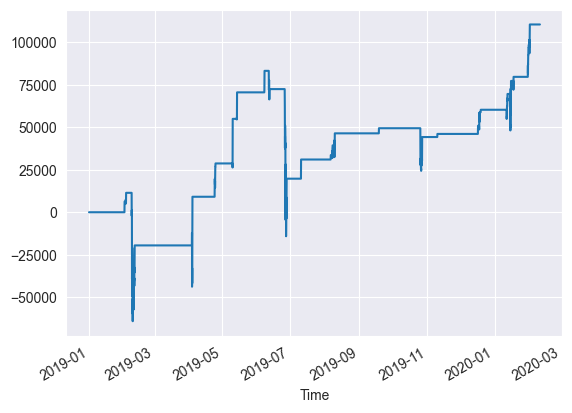

In [57]:
df = simulation(Crypto_Price, 'LTC',500, 2, 1_000_000)
df['PNL'].plot()

In [112]:
df['BTC order'].plot()

,BTC vs LTC,BTC Close Price,LTC Close Price,500h mean,500h std,long_signal,short_signal,signal,LTC order,BTC order,PNL
Time,,,,,,,,,,,
2019-01-01 00:00:00,123.508344,3700.31,29.96,NaN,NaN,0,0,0,0.000000,0,0.000000
2019-01-01 01:00:00,124.064896,3689.69,29.74,NaN,NaN,0,0,0,0.000000,0,0.000000
2019-01-01 02:00:00,124.158816,3690.00,29.72,NaN,NaN,0,0,0,0.000000,0,0.000000
2019-01-01 03:00:00,124.013768,3693.13,29.78,NaN,NaN,0,0,0,0.000000,0,0.000000
2019-01-01 04:00:00,123.419452,3692.71,29.92,NaN,NaN,0,0,0,0.000000,0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...
2020-02-10 10:00:00,134.422331,9847.78,73.26,141.199806,12.357088,0,0,0,1573.320474,15,262978.157961
2020-02-10 11:00:00,134.099263,9821.43,73.24,141.171461,12.340539,0,0,0,1573.320474,15,262551.441551
2020-02-10 12:00:00,133.196158,9845.86,73.92,141.139623,12.326166,0,0,0,1573.320474,15,263987.749474


In [ ]:
df